In [1]:
import xarray as xr

In [2]:
from dask.distributed import Client

client = Client("tcp://127.0.0.1:51796")
client

Client Scheduler: tcp://127.0.0.1:51796 Dashboard: http://127.0.0.1:51795/status,Cluster Workers: 4 Cores: 8 Memory: 34.36 GB


In [3]:
url = 'http://barataria.tamu.edu:8080/thredds/dodsC/NcML/forecast_his_archive_agg.nc'
ds = xr.open_dataset(url, chunks={'ocean_time': 1})
ds

<xarray.Dataset>
Dimensions:         (eta_psi: 190, eta_rho: 191, eta_u: 191, eta_v: 190, ocean_time: 13992, s_rho: 30, s_w: 31, tracer: 6, xi_psi: 670, xi_rho: 671, xi_u: 670, xi_v: 671)
Coordinates:
  * s_rho           (s_rho) float64 -0.9833 -0.95 -0.9167 ... -0.05 -0.01667
  * s_w             (s_w) float64 -1.0 -0.9667 -0.9333 ... -0.06667 -0.03333 0.0
    lon_rho         (eta_rho, xi_rho) float64 dask.array<chunksize=(191, 671), meta=np.ndarray>
    lat_rho         (eta_rho, xi_rho) float64 dask.array<chunksize=(191, 671), meta=np.ndarray>
    lon_u           (eta_u, xi_u) float64 dask.array<chunksize=(191, 670), meta=np.ndarray>
    lat_u           (eta_u, xi_u) float64 dask.array<chunksize=(191, 670), meta=np.ndarray>
    lon_v           (eta_v, xi_v) float64 dask.array<chunksize=(190, 671), meta=np.ndarray>
    lat_v           (eta_v, xi_v) float64 dask.array<chunksize=(190, 671), meta=np.ndarray>
    lon_psi         (eta_psi, xi_psi) float64 dask.array<chunksize=(190, 670), meta=np.ndarray>
    lat_psi         (eta_psi, xi_psi) float64 dask.array<chunksize=(190, 670), meta=np.ndarray>
  * ocean_time      (ocean_time) datetime64[ns] 2019-01-06T01:00:00 ... 2020-09-02
Dimensions without coordinates: eta_psi, eta_rho, eta_u, eta_v, tracer, xi_psi, xi_rho, xi_u, xi_v
Data variables:
    ntimes          int32 ...
    ndtfast         int32 ...
    dt              float64 ...
    dtfast          float64 ...
    dstart          datetime64[ns] ...
    shuffle         int32 ...
    deflate         int32 ...
    deflate_level   int32 ...
    nHIS            int32 ...
    ndefHIS         int32 ...
    nRST            int32 ...
    nSTA            int32 ...
    Falpha          float64 ...
    Fbeta           float64 ...
    Fgamma          float64 ...
    nl_tnu2         (tracer) float64 dask.array<chunksize=(6,), meta=np.ndarray>
    nl_visc2        float64 ...
    LuvSponge       int32 ...
    LtracerSponge   (tracer) int32 dask.array<chunksize=(6,), meta=np.ndarray>
    Akt_bak         (tracer) float64 dask.array<chunksize=(6,), meta=np.ndarray>
    Akv_bak         float64 ...
    Akk_bak         float64 ...
    Akp_bak         float64 ...
    rdrg            float64 ...
    rdrg2           float64 ...
    Zob             float64 ...
    Zos             float64 ...
    gls_p           float64 ...
    gls_m           float64 ...
    gls_n           float64 ...
    gls_cmu0        float64 ...
    gls_c1          float64 ...
    gls_c2          float64 ...
    gls_c3m         float64 ...
    gls_c3p         float64 ...
    gls_sigk        float64 ...
    gls_sigp        float64 ...
    gls_Kmin        float64 ...
    gls_Pmin        float64 ...
    Charnok_alpha   float64 ...
    Zos_hsig_alpha  float64 ...
    sz_alpha        float64 ...
    CrgBan_cw       float64 ...
    Znudg           float64 ...
    M2nudg          float64 ...
    M3nudg          float64 ...
    Tnudg           (tracer) float64 dask.array<chunksize=(6,), meta=np.ndarray>
    Tnudg_SSS       float64 ...
    rho0            float64 ...
    gamma2          float64 ...
    LuvSrc          int32 ...
    LwSrc           int32 ...
    LtracerSrc      (tracer) int32 dask.array<chunksize=(6,), meta=np.ndarray>
    LsshCLM         int32 ...
    Lm2CLM          int32 ...
    Lm3CLM          int32 ...
    LtracerCLM      (tracer) int32 dask.array<chunksize=(6,), meta=np.ndarray>
    LnudgeM2CLM     int32 ...
    LnudgeM3CLM     int32 ...
    LnudgeTCLM      (tracer) int32 dask.array<chunksize=(6,), meta=np.ndarray>
    spherical       int32 ...
    xl              float64 ...
    el              float64 ...
    Vtransform      int32 ...
    Vstretching     int32 ...
    theta_s         float64 ...
    theta_b         float64 ...
    Tcline          float64 ...
    hc              float64 ...
    grid            int32 ...
    Cs_r            (s_rho) float64 dask.array<chunksize=(30,), meta=np.ndarray>
    Cs_w            (s_w) float64 dask.array<chunksize=(31,), meta=np.

In [18]:
temp = ds.temp.sel(ocean_time='2020-08-15').isel(s_rho=-1).compute()
temp

<xarray.DataArray 'temp' (ocean_time: 24, eta_rho: 191, xi_rho: 671)>
array([[[30.67238 , 30.6759  , 30.687967, ..., 30.432938, 30.428108,
         30.425417],
        [30.669031, 30.682755, 30.695686, ..., 30.422216, 30.411285,
         30.422802],
        [30.66568 , 30.68484 , 30.704945, ..., 30.421133, 30.409674,
         30.41977 ],
        ...,
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan]],

       [[30.656147, 30.65972 , 30.671701, ..., 30.423155, 30.422201,
         30.422953],
        [30.652773, 30.66398 , 30.67662 , ..., 30.408163, 30.39925 ,
         30.423796],
        [30.651085, 30.666258, 30.682816, ..., 30.405546, 30.397902,
         30.421547],
        ...,
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan]],

       [[30.651957, 30.655157, 30.666557, ..., 30.411787, 30.416975,
         30.420916],
        [30.648989, 30.640795, 30.652082, ..., 30.390955, 30.382847,
         30.424967],
        [30.647919, 30.642973, 30.653526, ..., 30.38635 , 30.38136 ,
         30.42357 ],
        ...,
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan]],

       ...,

       [[30.648241, 30.65781 , 30.670286, ..., 30.425459, 30.435108,
         30.440987],
        [30.639503, 30.685822, 30.684042, ..., 30.442059, 30.44988 ,
         30.447268],
        [30.682405, 30.686922, 30.689713, ..., 30.460705, 30.459133,
         30.46337 ],
        ...,
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan]],

       [[30.655218, 30.672293, 30.672401, ..., 30.42047 , 30.42726 ,
         30.437113],
        [30.639008, 30.685087, 30.683472, ..., 30.43453 , 30.44239 ,
         30.447382],
        [30.681843, 30.691994, 30.692427, ..., 30.45331 , 30.454208,
         30.460087],
        ...,
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan]],

       [[30.648844, 30.66007 , 30.660374, ..., 30.419329, 30.426098,
         30.431368],
        [30.638514, 30.676575, 30.672424, ..., 30.423738, 30.430275,
         30.43707 ],
        [30.650644, 30.684227, 30.680645, ..., 30.43877 , 30.443142,
         30.450111],
        ...,
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan]]], dtype=float32)
Coordinates:
    s_rho       float64 -0.01667
    lon_rho     (eta_rho, xi_rho) float64 -95.48 -95.48 -95.48 ... -88.88 -88.87
    lat_rho     (eta_rho, xi_rho) float64 23.11 23.14 23.17 ... 30.85 30.86
  * ocean_time  (ocean_time) datetime64[ns] 2020-08-15 ... 2020-08-15T23:00:00
Dimensions without coordinates: eta_rho, xi_rho
Attributes:
    long_name:    potential temperature
    units:        Celsius
    time:         ocean_time
    grid:         grid
    location:     face
    field:        temperature, scalar, series
    _ChunkSizes:  [  1  15  96 336]

In [20]:
density = 0.8 * ds.salt - 0.2 * ds.temp
density

,Array,Chunk
Bytes,215.19 GB,15.38 MB
Shape,"(13992, 30, 191, 671)","(1, 30, 191, 671)"
Count,69962 Tasks,13992 Chunks
Type,float32,numpy.ndarray


In [22]:
surface_density = density.sel(ocean_time='2020-08-15').isel(s_rho=-1).compute()
surface_density

<xarray.DataArray (ocean_time: 24, eta_rho: 191, xi_rho: 671)>
array([[[23.122925, 23.121677, 23.114841, ..., 20.2457  , 20.27795 ,
         20.318317],
        [23.123909, 23.119345, 23.11209 , ..., 20.289198, 20.328377,
         20.3595  ],
        [23.122234, 23.11653 , 23.108227, ..., 20.343304, 20.38145 ,
         20.41107 ],
        ...,
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan]],

       [[23.126232, 23.125004, 23.11833 , ..., 20.260023, 20.291037,
         20.33003 ],
        [23.127207, 23.12323 , 23.11616 , ..., 20.303564, 20.34142 ,
         20.369835],
        [23.125286, 23.12041 , 23.112896, ..., 20.356796, 20.39332 ,
         20.420181],
        ...,
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan]],

       [[23.127125, 23.126003, 23.11963 , ..., 20.277504, 20.306849,
         20.344488],
        [23.128006, 23.128025, 23.121384, ..., 20.321861, 20.358532,
         20.382917],
        [23.126091, 23.12528 , 23.119085, ..., 20.374176, 20.409122,
         20.431892],
        ...,
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan]],

       ...,

       [[23.1289  , 23.127064, 23.124054, ..., 20.564936, 20.585041,
         20.60922 ],
        [23.13069 , 23.123089, 23.121605, ..., 20.591846, 20.611423,
         20.633888],
        [23.122414, 23.1217  , 23.118536, ..., 20.619144, 20.644104,
         20.664623],
        ...,
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan]],

       [[23.12756 , 23.124249, 23.123901, ..., 20.581295, 20.601448,
         20.624699],
        [23.130833, 23.123425, 23.122047, ..., 20.609539, 20.628258,
         20.64843 ],
        [23.122696, 23.120985, 23.118364, ..., 20.635672, 20.65876 ,
         20.678335],
        ...,
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan]],

       [[23.12889 , 23.126778, 23.126583, ..., 20.59819 , 20.61701 ,
         20.641378],
        [23.13097 , 23.12535 , 23.124584, ..., 20.628153, 20.64808 ,
         20.666206],
        [23.129103, 23.122833, 23.121058, ..., 20.654625, 20.675713,
         20.694233],
        ...,
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan]]], dtype=float32)
Coordinates:
    s_rho       float64 -0.01667
    lon_rho     (eta_rho, xi_rho) float64 -95.48 -95.48 -95.48 ... -88.88 -88.87
    lat_rho     (eta_rho, xi_rho) float64 23.11 23.14 23.17 ... 30.85 30.86
  * ocean_time  (ocean_time) datetime64[ns] 2020-08-15 ... 2020-08-15T23:00:00
Dimensions without coordinates: eta_rho, xi_rho

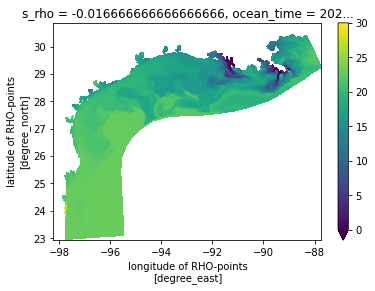

In [26]:
surface_density[0].plot(x='lon_rho', y='lat_rho', vmin=0, vmax=30)